In [1]:
# Install dependencies
!pip install mediapipe

In [7]:
import cv2
import matplotlib.pyplot as plt
from mosaic import FaceMosaic

In [8]:
def image_resize(image, width = None, height = None, inter = cv2.INTER_AREA):
    # initialize the dimensions of the image to be resized and
    # grab the image size
    dim = None
    (h, w) = image.shape[:2]

    # if both the width and height are None, then return the
    # original image
    if width is None and height is None:
        return image

    # check to see if the width is None
    if width is None:
        # calculate the ratio of the height and construct the
        # dimensions
        r = height / float(h)
        dim = (int(w * r), height)

    # otherwise, the height is None
    else:
        # calculate the ratio of the width and construct the
        # dimensions
        r = width / float(w)
        dim = (width, int(h * r))

    # resize the image
    resized = cv2.resize(image, dim, interpolation = inter)

    # return the resized image
    return resized

In [3]:
fm = FaceMosaic()
results = fm.detect_landmarks([
    r'D:\ComputerScience\Mestrado\src\mosaic-2.0\test.jpg',
    r'D:\ComputerScience\Mestrado\data\UNIFESP\all\01_113607.bmp',
    r'D:\ComputerScience\Mestrado\data\images\f3.jpg',
])

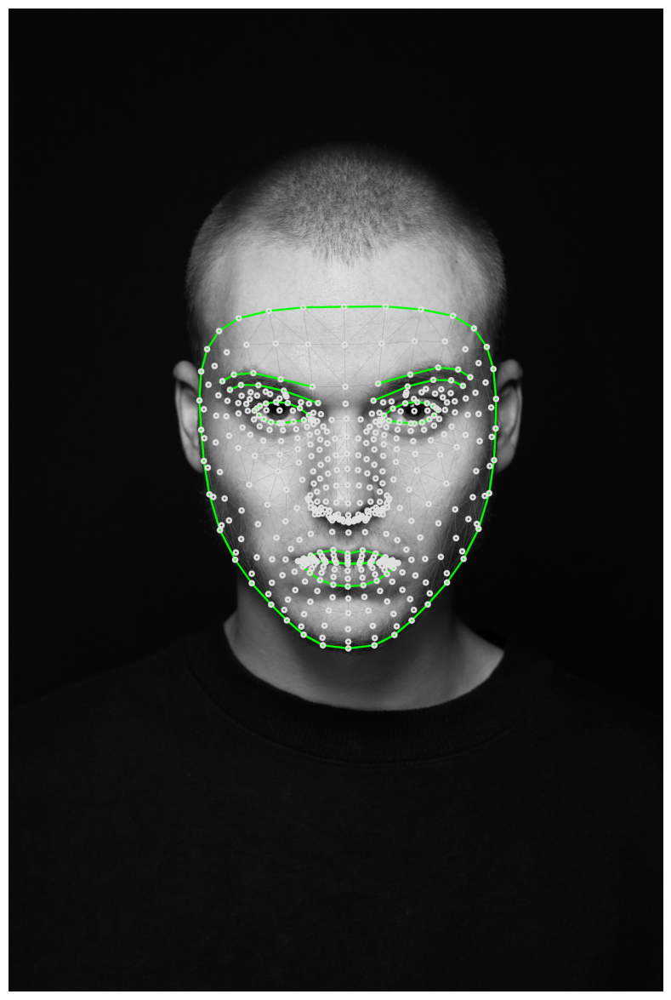

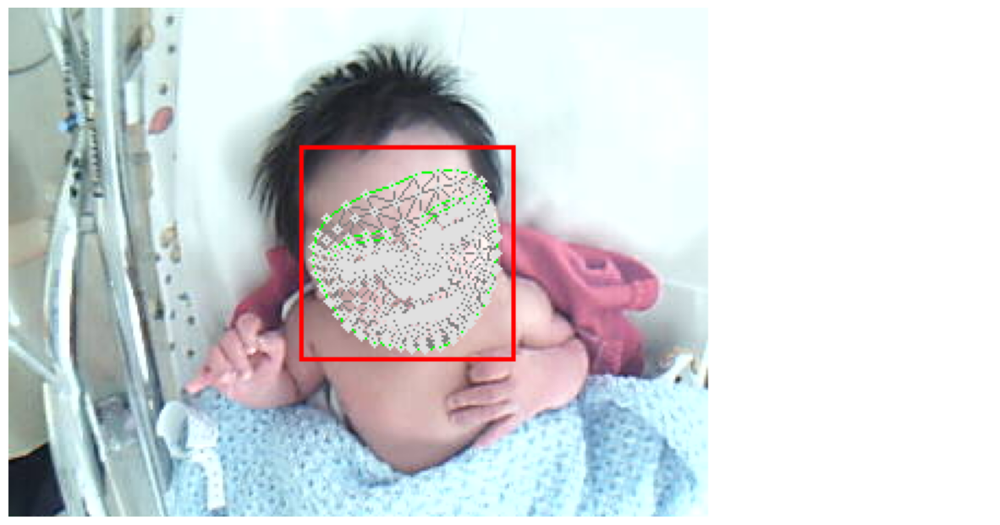

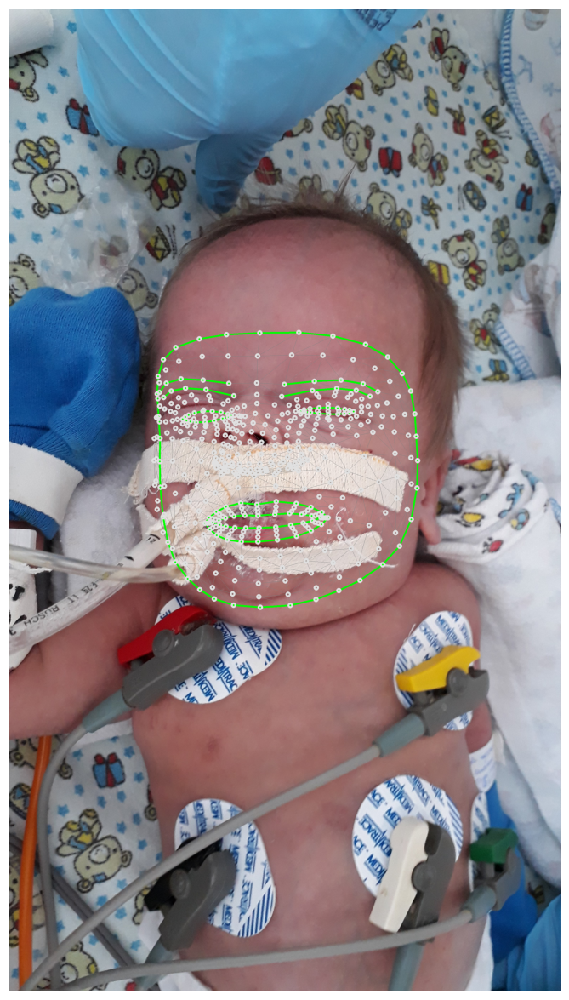

In [4]:
for result in results:
    fig = plt.figure(figsize=(15,15))
    img = fm.draw_landmarks(*result)
    plt.imshow(image_resize(img, width=300))
    plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


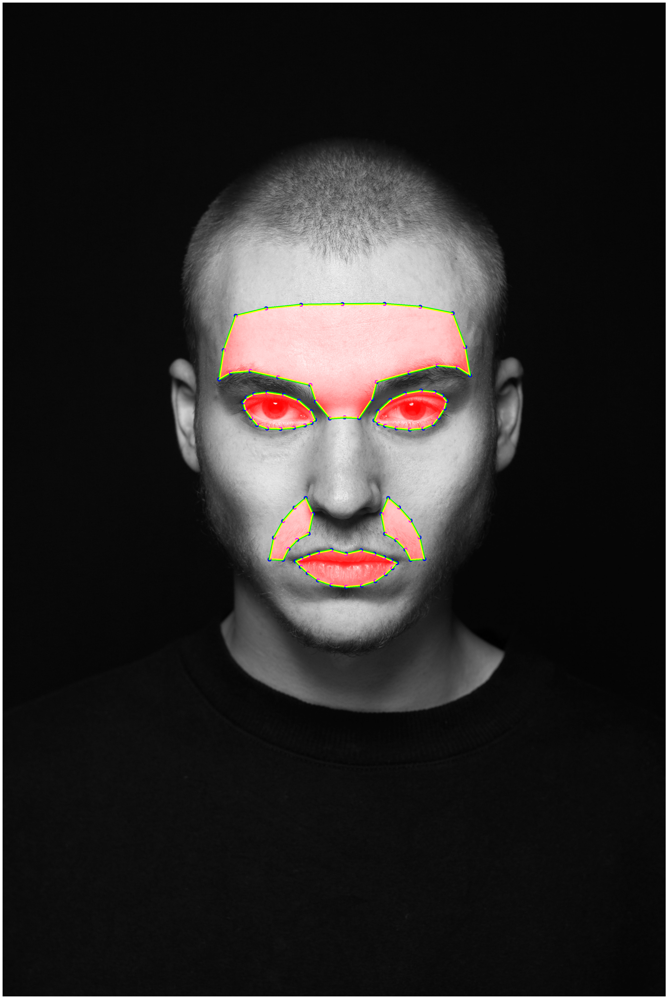

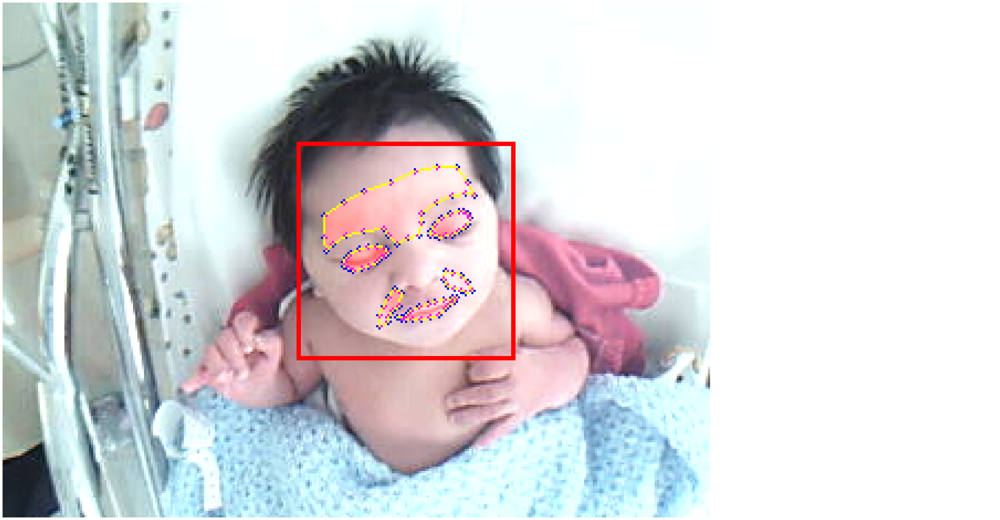

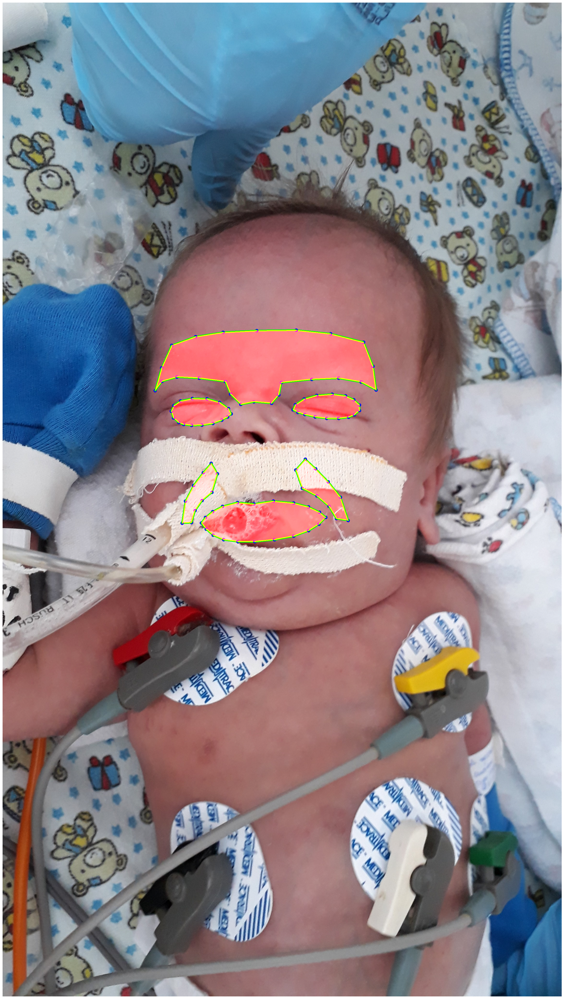

In [5]:
for result in results:
    fig = plt.figure(figsize=(50,50))
    plt.imshow(fm.draw_mosaic(*result, points=True, lines=True))
    plt.axis('off')

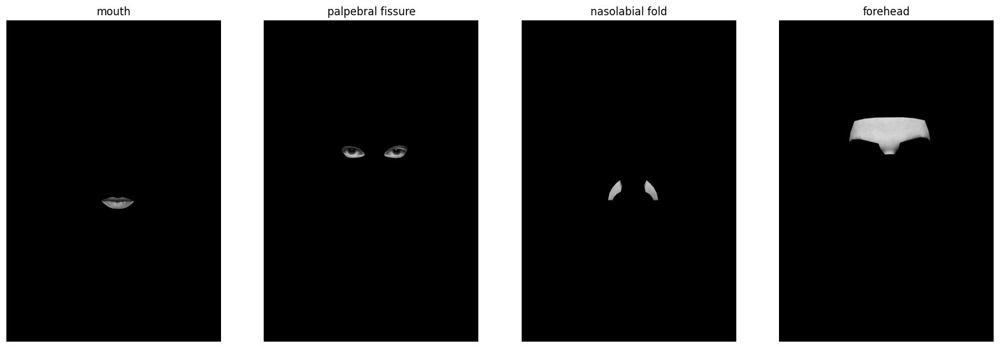

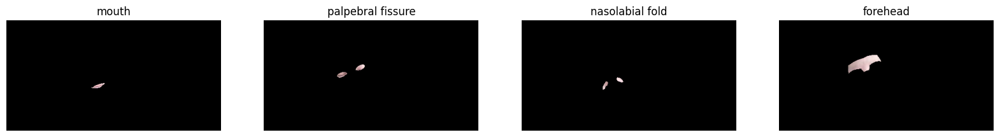

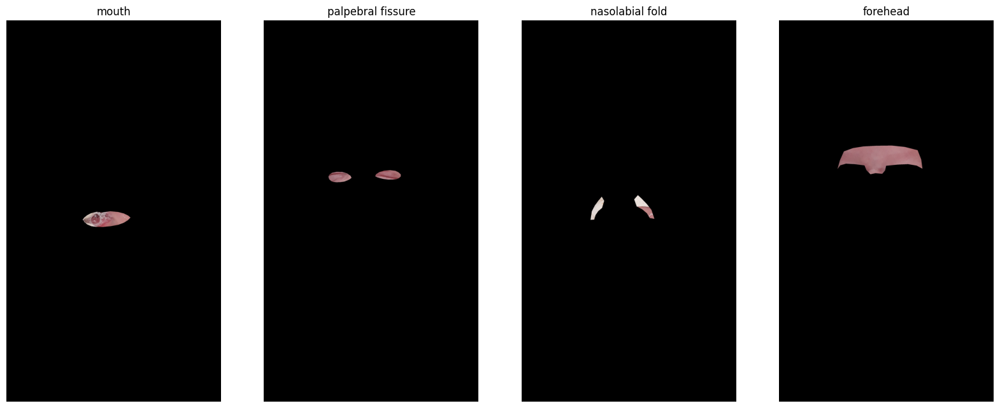

In [6]:
for result in results:
    detection_result, image = result 
    data = fm.create_masks(*result)
    fig, axs = plt.subplots(1, 4, figsize=(20,50))
    for i, (key, value) in enumerate(data.items()):
        axs[i].imshow(fm.apply_mask(image, value))
        axs[i].set_title(key)
        axs[i].axis('off')
    plt.show()